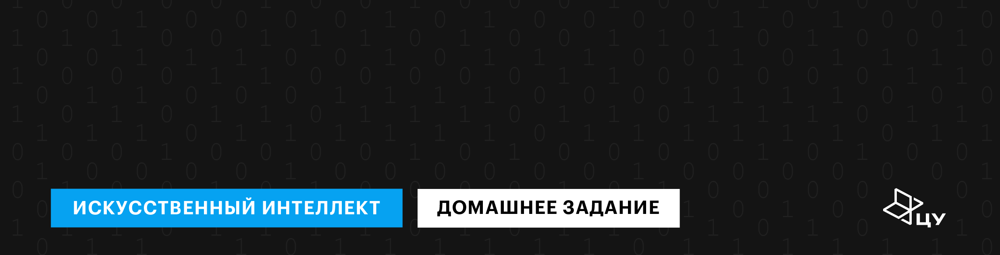

## Домашнее задание по теме «Задачи с изображениями»

В этом задании ты научишься уверенно работать со свёрточными сетями и применять их для творчества. Для этого мы воспроизведём оригинальную статью Neural Style Transfer 2015 года, [Gatys et al.](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf)

## Подготовка

In [1]:
!gdown 'https://drive.google.com/uc?export=download&id=1aFzDMBgXjaB_BWO2bxT300gTv_lRH_3Q'

!gdown 'https://drive.google.com/uc?export=download&id=11WCU7-lgS9FeMdun10Cod5pz7N94pLGU'


Downloading...
From: https://drive.google.com/uc?export=download&id=1aFzDMBgXjaB_BWO2bxT300gTv_lRH_3Q
To: /content/comp_7.jpg
100% 62.0k/62.0k [00:00<00:00, 76.2MB/s]
Downloading...
From: https://drive.google.com/uc?export=download&id=11WCU7-lgS9FeMdun10Cod5pz7N94pLGU
To: /content/main.jpg
100% 359k/359k [00:00<00:00, 75.2MB/s]


In [2]:
import torch
import torchvision.transforms as transforms
import torchvision.models as models

import numpy as np

import cv2
import matplotlib.pyplot as plt

# assert torch.cuda.is_available()
device = torch.device('cuda') #oops

torch.manual_seed(2025);

Разберём, в чём заключается задача переноса стиля.

1. Есть исходное изображение $S$, определяющее стиль (**style**). Это изображение характеризуется уникальной цветовой палитрой, текстурой и другими художественными особенностями.

![Композиция VII.](https://www.theartstory.org/images20/works/kandinsky_wassily_4.jpg?3)

*В. Кандинский. Композиция VII. 1913*

2. Есть исходное изображение $C$, определяющее содержание (**content**). Это изображение содержит объекты и структуры, которые необходимо сохранить в итоговом изображении.


![ГЗ МГУ.](https://msu.ru/upload/iblock/264/iiv5nqc02lbam4zg53l2y2gyftrwy7kv/main.jpg)

*Главное здание МГУ*. [Источник](https://msu.ru/upload/iblock/264/iiv5nqc02lbam4zg53l2y2gyftrwy7kv/main.jpg)

Требуется:

Реализовать алгоритм, который создаст новое изображение $I$, у которого:
- семантическое содержание (важные элементы и структура) из исходного изображения $C$;
- стиль (цветовая палитра и текстурные особенности) из исходного изображения $S$.

Общая идея решения, которое нужно реализовать: некоторым образом извлечь представление содержания из картинки $C$, представление стиля из картинки $S$ и, пользуясь ими, создать новую картинку.

In [3]:
def to_rgb(bgr_img):
    rgb_image = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
    return rgb_image

def load_img(path):
    return to_rgb(cv2.imread(path))

def resize_to_shape(img, shape):
    return cv2.resize(img, shape[::-1], interpolation=cv2.INTER_CUBIC)

def plot_2_img(img1, img2):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    axs[0].imshow(img1)

    axs[1].imshow(img2)

    plt.tight_layout()
    plt.show()

Загрузим картинки, приведём их к одному размеру (обязательное условие для `style transfer`) и отрисуем.

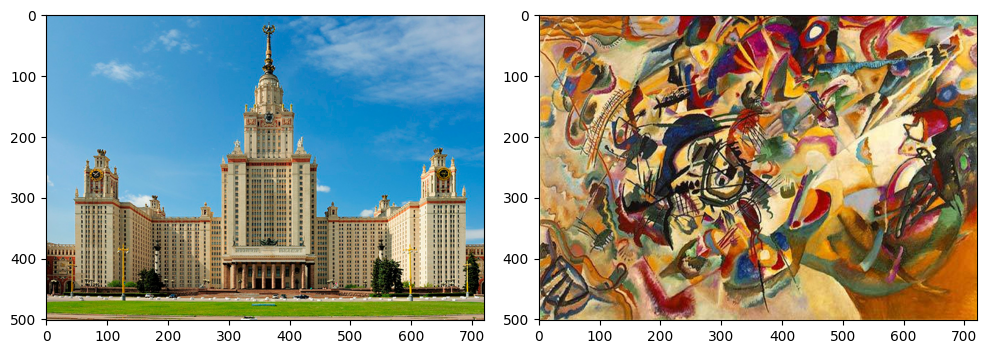

In [4]:
main = load_img('main.jpg')
comp_7 = resize_to_shape(load_img('comp_7.jpg'), main.shape[:2])

plot_2_img(main, comp_7)

Нейроискусство не имеет конкретной метрики, которую можно оптимизировать. Как и в любом творчестве, самая главная метрика — наше восприятие. Поэтому некоторые вещи, например нормализация изображения перед передачей его в сеть, становятся опциональными и остаются на усмотрение художника.

В данном случае предлагается нормализовать картинки из интервала значений `np.uint8`, то есть `[0, 255]`. По мнению авторов этого материала, так результаты получаются более красивыми. Но если ты решишь поменять нормализацию или убрать её совсем, то баллы за это не снимут.

Определим функцию, которая переводит изображение в тензор, который можно будет передавать в модель.

In [5]:
IMAGENET_MEAN_255 = [123.675, 116.28, 103.53]
IMAGENET_STD_NEUTRAL = [1, 1, 1]

def prepare_input(image):
    if isinstance(image, str):
        image = Image.open(image)
    preprocess = transforms.Compose([
            transforms.ToTensor(),
            # ToTensor переводит картинку в интервал [0, 1]
            transforms.Lambda(lambda x: x.mul(255)),
            # Lambda позволяет применить произвольную функцию к картинке: переведём её обратно в диапазон значения [0, 255]
            transforms.Normalize(mean=IMAGENET_MEAN_255, std=IMAGENET_STD_NEUTRAL)
            # Отнормируем в этом диапазоне
        ])

    image = preprocess(image)
    image = image.unsqueeze(0)
    return image

Определим также функцию, которая преобразует тензор обратно в картинку.

In [6]:
def to_uint8_range(array):
    x = array - np.min(array)
    x /= np.max(x)
    x *= 255
    return x.astype(np.uint8)


def prepare_output(img_tensor):
    out = img_tensor[0]
    out = out.cpu().detach().numpy().transpose(1, 2, 0)
    out = to_uint8_range(out)
    return out

In [7]:
main_tensor = prepare_input(main).to(device)
comp_7_tensor = prepare_input(comp_7).to(device)

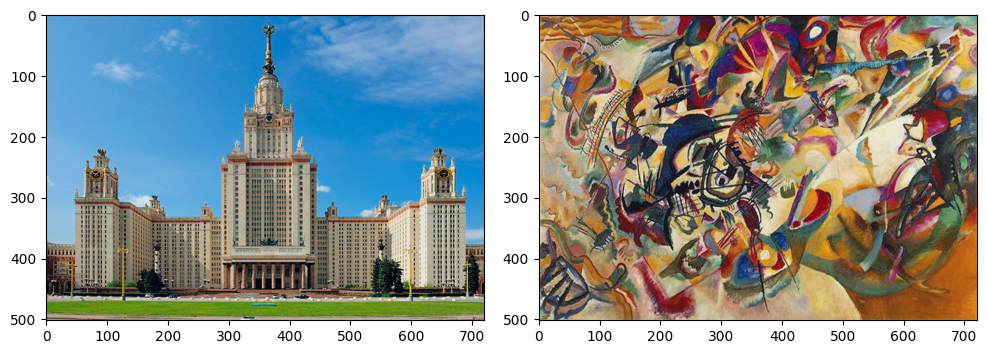

In [8]:
plot_2_img(prepare_output(main_tensor), prepare_output(comp_7_tensor))

Как и в оригинальной статье, будем использовать модель **VGG19**.

In [9]:
def init_model(device):
    model = models.vgg19(weights='IMAGENET1K_V1') # Выбираем модель, предобученную на ImageNet
    model.to(device) # Переносим на девайс
    for param in model.parameters(): # Отключаем градиенты
       param.requires_grad_(False)
    model.eval(); # Переводим в eval-режим
    for module in model.modules(): # Меняем inplace ReLU на обычный, это нужно для корректной работы forward hooks
        if isinstance(module, torch.nn.ReLU):
            module.inplace = False
    for name, module in model.features.named_children(): # Меняем MaxPool-слои на AvgPool. Авторы статьи считают, что так красивее
        if isinstance(module, torch.nn.MaxPool2d):
            kernel_size = module.kernel_size
            stride = module.stride
            padding = module.padding
            model.features[int(name)] = torch.nn.AvgPool2d(kernel_size=kernel_size, stride=stride, padding=padding)
    return model

In [10]:
model = init_model(device)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:04<00:00, 134MB/s]


## Content Representation

Каждый свёрточный слой представляет собой банк фильтров, который применяется ко входному тензору и сложность которых увеличивается с глубиной слоя.

Слой с $N_l$ различными фильтрами имеет $N_l$ карт признаков, каждая из которых имеет размер $M_l$, где
$$
M_l = height(tensor) \times width(tensor).
$$

Таким образом, активации на уровне $l$ могут быть сохранены в матрице
$$
F_l \in \mathbb{R}^{N_l \times M_l},
$$

где $F_{l_{ij}}$ — это активация $i$-го фильтра в позиции $j$ в слое $l$.

Чтобы визуализировать информацию об изображении, которая кодируется на различных уровнях модели, можно выполнить градиентный спуск на изображении белого шума.

Пусть $\tilde{C}$ и $\tilde{X}$ — это оригинальное и сгенерированное изображения, а $P_l$ и $F_l$ — их соответствующие представления признаков в слое $l$. Тогда можно определить функцию потерь по среднеквадратичной ошибке между двумя представлениями признаков:

$$
L_{\text{content}}(\tilde{C}, \tilde{X}, l) = MSE(F_{l_{ij}}, P_{l_{ij}}) = \frac{1}{2} \sum_{i,j} (F_{l_{ij}} - P_{l_{ij}})^2.
$$

Таким образом, если запустить оптимизационный процесс, минимизирующий функцию ошибки выше, то изначальное шумное изображение $\tilde{x}$ будет меняться до тех пор, пока оно не будет генерировать тот же отклик на определённом слое свёрточной нейронной сети, что и оригинальное изображение.


In [11]:
model.features

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU()
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU()
  (4): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU()
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU()
  (9): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU()
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU()
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU()
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU()
  (18): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (19): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (20): ReLU()
  (21): Conv2d(512, 512

Для того чтобы записывать промежуточные выходы слоёв, будем пользоваться `forward_hook`, как и на семинаре.

In [12]:
class SaveFeature():
    def __init__(self, model, layer_num):
        module = model.features[layer_num]
        self.hook = module.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output):
        self.features = output.requires_grad_(True).to(device)

In [13]:
# Инициализируем хук на определённом слое (в данном случае это слой ReLU() на позиции 3)
activation = SaveFeature(model, 3)

# Прогоняем тензор через модель
# Во время прогона хук сохраняет промежуточные результаты
model(main_tensor)

# Обратись в инстанс класса SaveFeature за результатами
target_content_emb = activation.features.clone().detach().to(device)
print(target_content_emb.shape)

torch.Size([1, 64, 502, 721])


In [14]:
# Если прогнать через модель другую картинку,
model(comp_7_tensor)
other_content_emb = activation.features.clone().detach().to(device)

# то activation.feature перезапишется и будет хранить уже новое представление
assert target_content_emb[0, 0, 0, 0] != other_content_emb[0, 0, 0, 0]

### Задача 1 [3 балла]

Получи представление содержания картинки `main`, используя слой `22`. **[0,5 балла]**

In [15]:
model = init_model(device)

### Напиши свой код здесь
activation =  SaveFeature(model, 22)
model(main_tensor)
target_content_emb = activation.features.clone().detach().to(device)


1. Создай картинку с шумом того же размера, что и картинка `main`. Шум может быть любой (белый, розовый, коричневый, гауссовский и так далее). **[0,5 балла]**
2. Преобразуй эту картинку в тензор. **[0,5 балла]**
3. Получи представление содержания шумной картинки, также используя слой `22`. **[0,5 балла]**

In [16]:
#1. [0,5 балла]
noisy_img = np.random.randint(0, 256, main.shape, dtype=np.uint8)
noisy_tensor = prepare_input(noisy_img).to(device).requires_grad_(True)


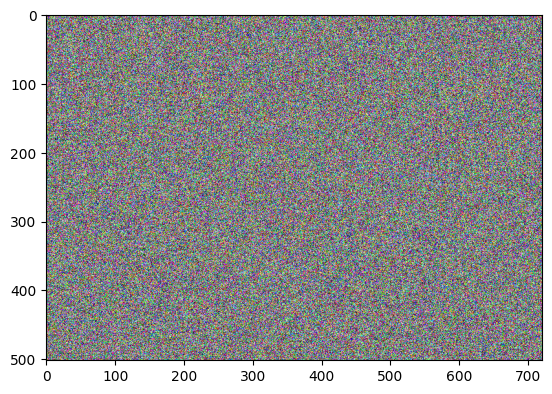

In [17]:
plt.imshow(noisy_img)

Теперь осталось оптимизировать шумный тензор, пока его эмбеддинг содержания не совпадёт с эмбеддингом содержания оригинальной картинки. Будет понятно, что это случилось, когда на шумной картинке проступят узнаваемые контуры главного здания МГУ.

Как и в оригинальной статье, будем пользоваться оптимизатором второго порядка `L-BFGS`. С ним сходимость будет более быстрой.

In [18]:
num_iter = 1000
plot_every = 100

criterion = torch.nn.MSELoss(reduction='mean')
optimizer = torch.optim.LBFGS((noisy_tensor, ), max_iter=num_iter, tolerance_grad=0, tolerance_change=0, line_search_fn='strong_wolfe')

`L-BFGS` немного отличается по интерфейсу от привычного `Adam`. Чтобы им воспользоваться, необходимо определить функцию `closure`, которая не принимает никаких аргументов, а на выход выдаёт значениe `loss`. Эту функцию нужно передать в метод `step` оптимизатора.

Заполни пропуски в функции `closure`. **[1 балл]**

In [19]:
plot_counter = 0
def closure():
    global plot_counter
    optimizer.zero_grad()
    model(noisy_tensor)
    current_emb = activation.features
    loss = criterion(current_emb, target_content_emb)
    loss.backward()

    plot_counter += 1

    if plot_counter % plot_every == 0:
        with torch.no_grad():
            print(f'Iteration: {plot_counter}, current loss={loss.item()}')
            plt.imshow(prepare_output(noisy_tensor.clone().detach()))
            plt.show()
    return loss

Iteration: 100, current loss=29.691856384277344


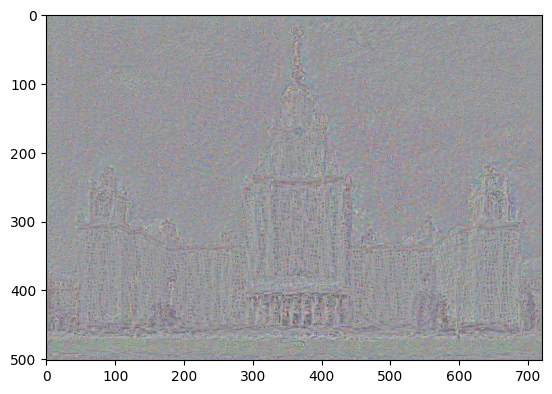

Iteration: 200, current loss=14.670829772949219


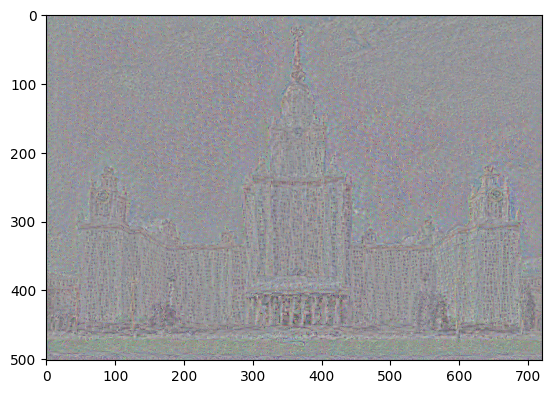

Iteration: 300, current loss=10.117720603942871


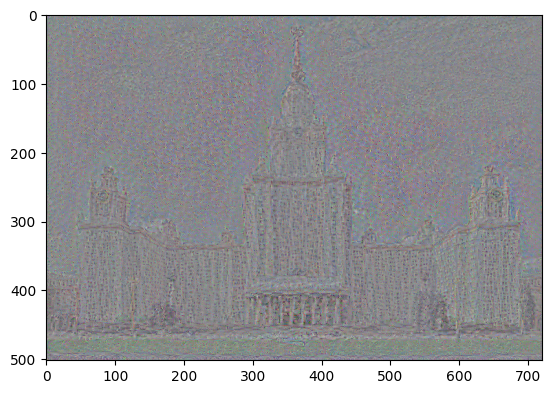

Iteration: 400, current loss=7.937348365783691


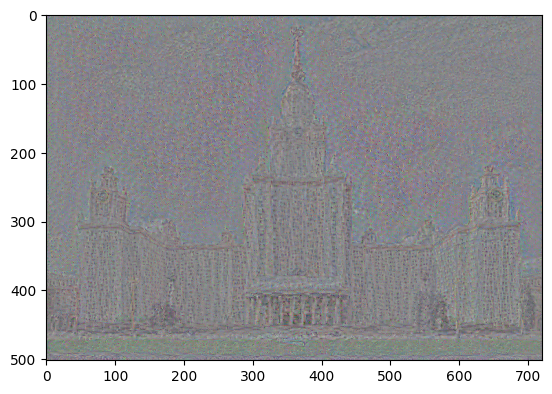

Iteration: 500, current loss=6.642589092254639


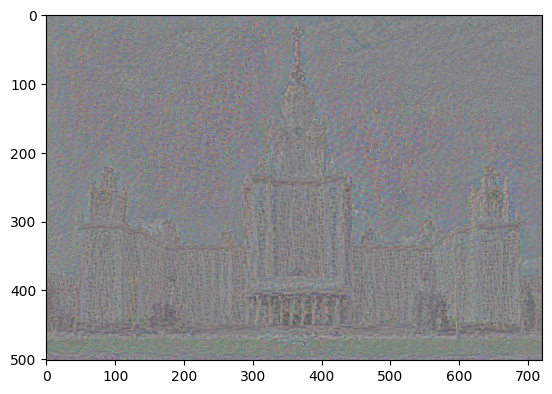

Iteration: 600, current loss=5.761442184448242


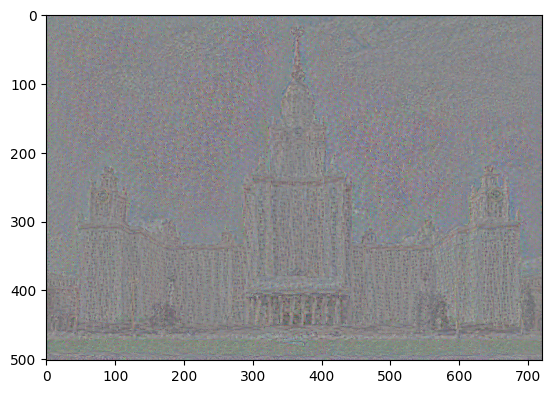

Iteration: 700, current loss=5.13024377822876


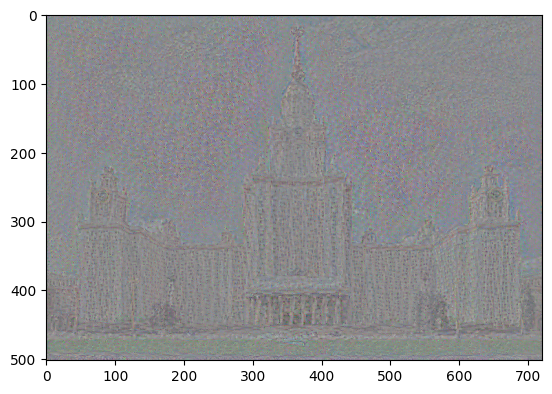

Iteration: 800, current loss=4.653259754180908


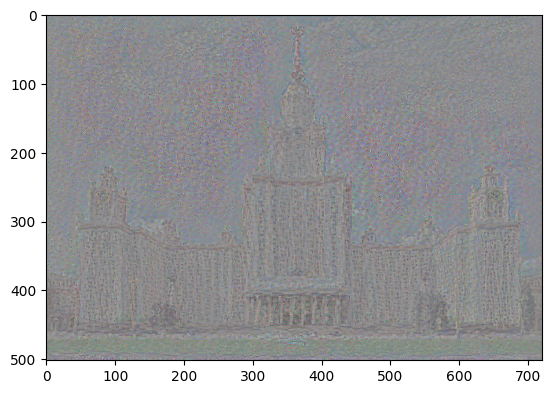

Iteration: 900, current loss=4.283306121826172


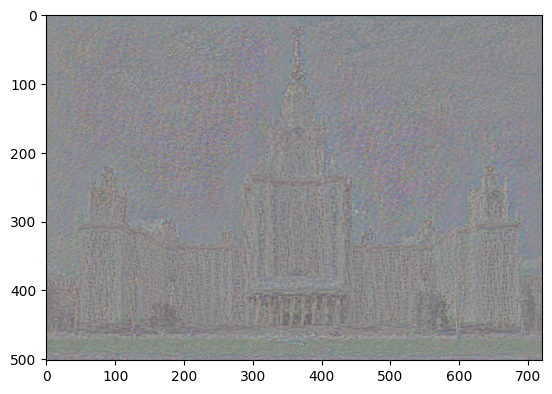

Iteration: 1000, current loss=3.9885895252227783


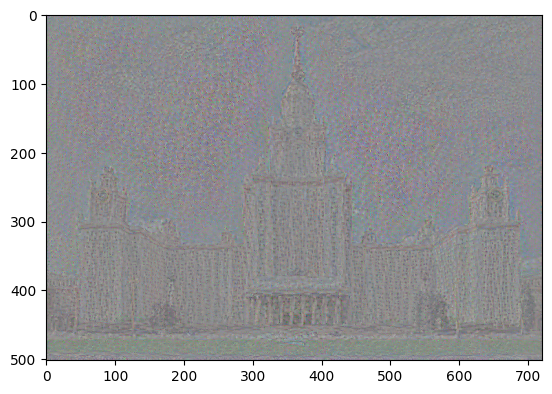

In [20]:
optimizer.step(closure);

Final Iteration


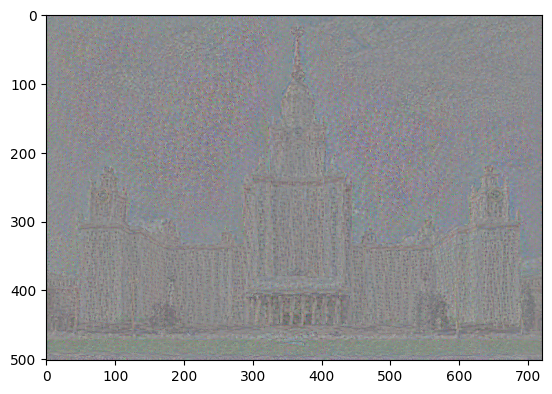

In [21]:
print('Final Iteration')
plt.imshow(prepare_output(noisy_tensor))
plt.show()

Если всё сделано правильно, то на получившейся картинке можно будет увидеть очертания здания.

### Задача 2 [5 дополнительных баллов]

1. Слой для представления был выбран очень глубокий. Что будет, если выбрать более ранний слой? Визуализируй представление для слоёв 3, 11 и 17. Сделай вывод. **[1 дополнительный балл за каждый слой, максимум 3 балла]**
2. Попробуй получить то же самое представление, но с использованием `Adam`. Напиши, что изменилось. Какой метод оптимизации эффективнее? **[2 дополнительных балла]**

1. будут более крупные детали, более мелкие будут отсутствовать т.к более верхние слои отвечают за более высокий уровень абстракции

2. Сходимость будет медленнее для данной задачи

3. Лень реализовывать, просто размышления

## Style Representation

Для представления стиля изображения вводится пространство признаков, которое предназначено для захвата текстурной информации. Это пространство признаков может быть построено на основе активаций фильтров в нескольких слоях сети. Оно состоит из корреляций между разными активациями фильтров. Эти корреляции признаков выражаются матрицей Грама:
$$
G^l \in \mathbb{R}^{N_l \times N_l},
$$

где $G^l_{ij}$ — это скалярное произведение векторизованных карт признаков $i$ и $j$ в слое $l$:

$$
G^l_{ij} = \sum_k F^l_{ik} F^l_{jk}. \quad
$$

Если включить корреляции признаков из разных слоёв в общее представление, мы получаем усреднённое представление изображения, которое корректно улавливает его текстурную информацию, но не конкретное содержание.

Мы можем визуализировать информацию, захваченную этими стилевыми пространствами признаков, построенными на разных слоях сети, создавая изображение, которое соответствует стилевому представлению данного входного изображения. Это тоже достигается с помощью градиентного спуска из изображения с белым шумом для минимизации среднеквадратичного отклонения между элементами матриц Грама из оригинального изображения и матриц Грама изображения, которое будет сгенерировано.

Пусть $\tilde{S}$ и $\tilde{X}$ — это оригинальное и сгенерированное изображения, а $A^l$ и $G^l$ — их соответствующие представления стиля (матрицы Грама) в слое $l$. Вклад слоя $l$ в суммарную потерю выражается как

$$
E^l = \sum_{i, j}\left( \frac{G^l_{ij}}{2N_l M_l} - \frac{A^l_{ij}}{2N_l M_l} \right)^2 = \frac{1}{4N_l^2 M_l^2} \sum_{i,j} \left( G^l_{ij} - A^l_{ij} \right)^2, \quad
$$

и общая стилистическая функция потерь будет

$$
L_{\text{style}}(\tilde{S}, \tilde{X}) = \sum_{l=0}^{L} w_l E^l,
$$

где $w_l$ — это весовые коэффициенты вклада каждого слоя в общую потерю.

### Задача 3 [3 балла]

1. Реализуй функцию `gram_matrix`, которая принимает на вход тензор размером `(batch_size, n_channels, height, width)` и возвращает нормализованную матрицу Грама этого тензора размерности `(batch_size, n_channels)`. **[1 балл]**

In [22]:
def gram_matrix(input_tensor):
    b, ch, h, w = input_tensor.size()
    features = input_tensor.view(b, ch, -1)
    gram = torch.bmm(features, features.transpose(1, 2))
    gram = gram / (h * w)
    return gram

In [23]:
# Реализация может быть неверной, даже если она проходит тесты ниже, поэтому действуй аккуратно

result = gram_matrix(target_content_emb)
assert result.shape == (target_content_emb.shape[0], target_content_emb.shape[1], target_content_emb.shape[1])
assert torch.allclose(result, result.transpose(1, 2)) # Должна быть симметричной

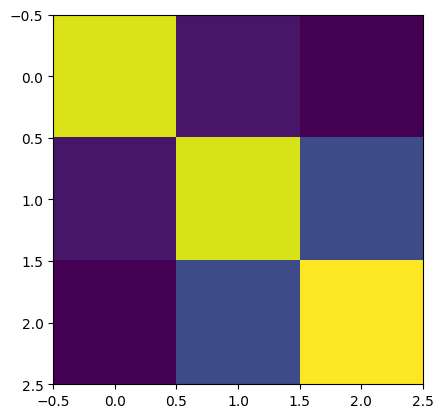

In [24]:
plt.imshow(gram_matrix(noisy_tensor.clone().detach())[0].cpu().numpy())

Немного отойдём от оригинальной статьи и будем считать матрицы Грама на основе выходов слоёв ReLU. В оригинальной статье использовались выходы непосредственно самих свёрточных слоёв.

In [25]:
layer_nums = [1, 6, 11, 20, 29]
model = init_model(device)
for num in layer_nums:
    print(f'{num - 1}: {model.features[num-1]}')
    print(f'{num}: {model.features[num]}')
    print()

0: Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
1: ReLU()

5: Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
6: ReLU()

10: Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
11: ReLU()

19: Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
20: ReLU()

28: Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
29: ReLU()



In [26]:
activations = [SaveFeature(model, num) for num in layer_nums]

Функция для подсчёта матриц Грама на основе промежуточных выходов разных слоёв.

In [27]:
def get_grams(activations: list, detach=False):
    if detach:
        return [gram_matrix(activation.features.clone().detach().to(device)) for activation in activations]
    return [gram_matrix(activation.features.to(device)) for activation in activations]

Пользуясь функцией `get_grams` и списком `activations`, получи:
1. Список `style_grams_gt` матриц Грама промежуточных выходов модели по изображению `comp_7`. **[0,25 балла]**
2. Список `style_grams_noisy` матриц Грама промежуточных выходов модели по **новому** шумному изображению. **[0,25 балла]**

In [28]:
## Напиши свой код здесь
model(comp_7_tensor)
style_grams_gt = [gram_matrix(activation.features.clone().detach()) for activation in activations]


## Напиши свой код здесь
noisy_img = np.random.randint(0, 256, comp_7.shape, dtype=np.uint8)
noisy_tensor = prepare_input(noisy_img).to(device).requires_grad_(True)
model(noisy_tensor)
style_grams_noisy = [gram_matrix(activation.features) for activation in activations]

In [29]:
assert len(style_grams_gt) == len(style_grams_noisy) == len(layer_nums)

for i in range(len(style_grams_gt)):
    assert not style_grams_gt[i].requires_grad

for i in range(len(style_grams_noisy)):
    assert style_grams_noisy[i].requires_grad

Инициализируем `loss`.

In [30]:
num_iter = 4000
criterion = torch.nn.MSELoss(reduction='sum')
optimizer = torch.optim.LBFGS((noisy_tensor, ), max_iter=num_iter, lr=1.5, tolerance_grad=0, tolerance_change=0,
                                  line_search_fn='strong_wolfe')

Реализуй функцию `calculate_loss`, которая считает общий `loss` по представлениям стиля. Все коэффициенты $w_l$ возьми равными `1/len(style_grams_gt)`. **[0,5 балла]**

In [31]:
def calculate_style_loss(criterion, grams_gt, grams_curr):
    loss = 0
    for gt, curr in zip(grams_gt, grams_curr):
        loss += criterion(gt, curr) / (4 * (gt.shape[1] ** 2) * (gt.shape[-1] ** 2))
    return loss / len(grams_gt)

Заполни пропуски в функции `closure`. **[1 балл]**

In [32]:
plot_every = lambda x: 20 if x < 70 else 400

style_coef = 1e6
content_coef = 1e2
style_layers = [1, 6, 11, 20, 29]
content_activation = SaveFeature(model, 22)  # Хук для контента
style_activations = [SaveFeature(model, l) for l in style_layers]


content_criterion = torch.nn.MSELoss(reduction='mean')
style_criterion = torch.nn.MSELoss(reduction='sum')

plot_counter = 0
def closure():
    global plot_counter
    optimizer.zero_grad()

    model(noisy_tensor)

    content_loss = content_coef * content_criterion(
        content_activation.features,
        target_content_emb
    )

    curr_style_grams = get_grams(style_activations)
    style_loss = style_coef * calculate_style_loss(
        style_criterion,
        style_grams_gt,
        curr_style_grams
    )

    total_loss = content_loss + style_loss
    total_loss.backward()

    if plot_counter % 100 == 0:
        print(f"Iteration {plot_counter}: Total Loss = {total_loss.item()}")
        plt.imshow(prepare_output(noisy_tensor.clone().detach()))
        plt.show()
    plot_counter += 1
    return total_loss

Iteration 0: Total Loss = 111782128.0


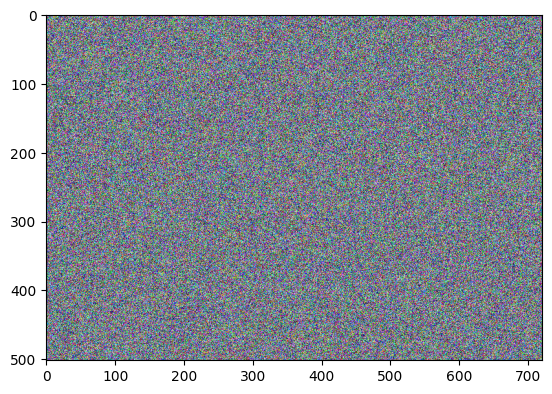

Iteration 100: Total Loss = 141192.84375


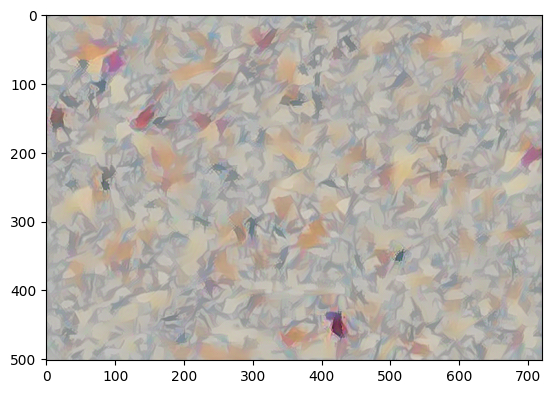

Iteration 200: Total Loss = 83921.2421875


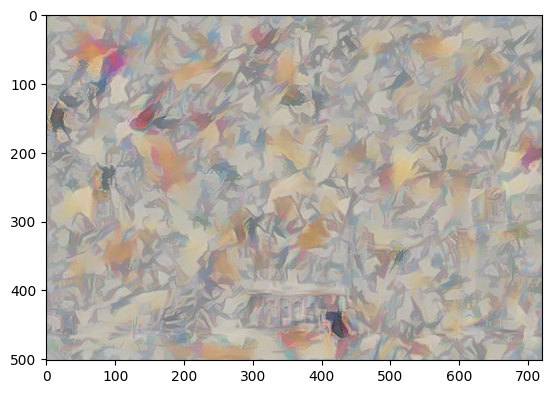

Iteration 300: Total Loss = 64352.34375


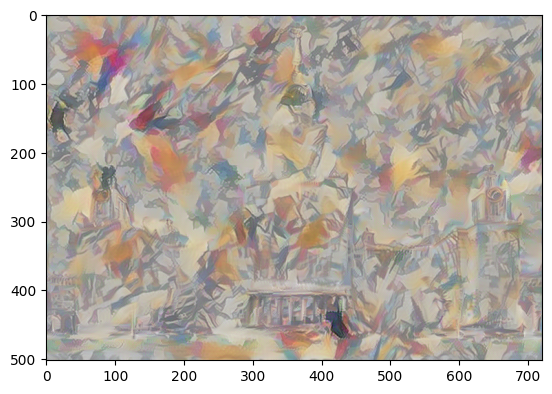

Iteration 400: Total Loss = 54497.765625


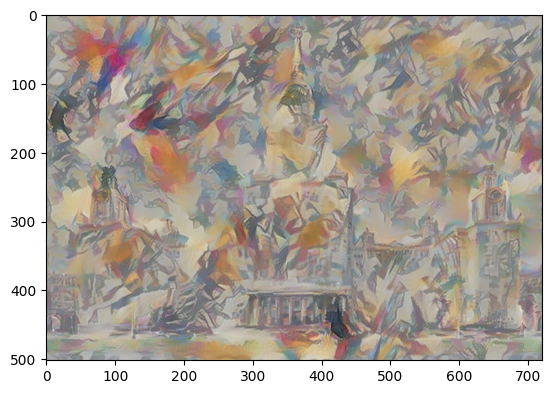

Iteration 500: Total Loss = 48386.6015625


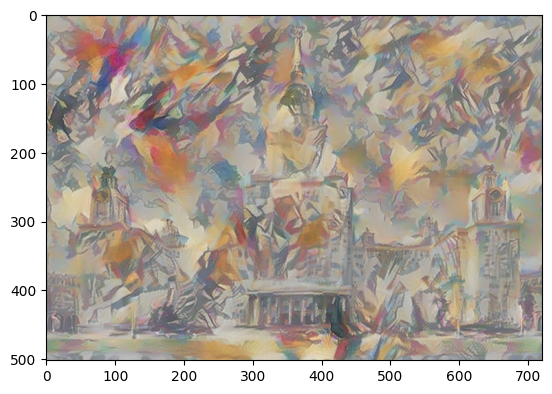

Iteration 600: Total Loss = 44352.20703125


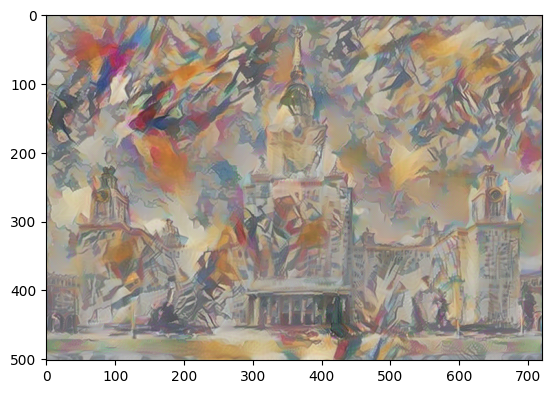

Iteration 700: Total Loss = 41533.546875


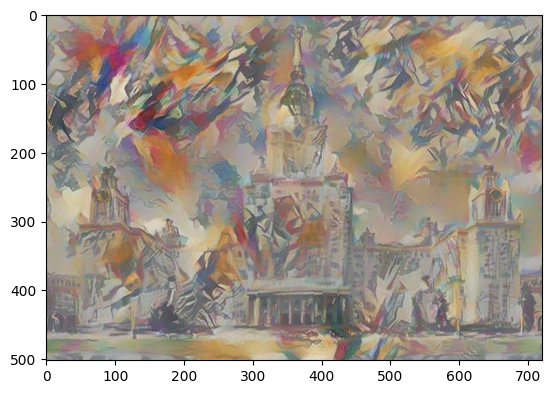

Iteration 800: Total Loss = 39392.0703125


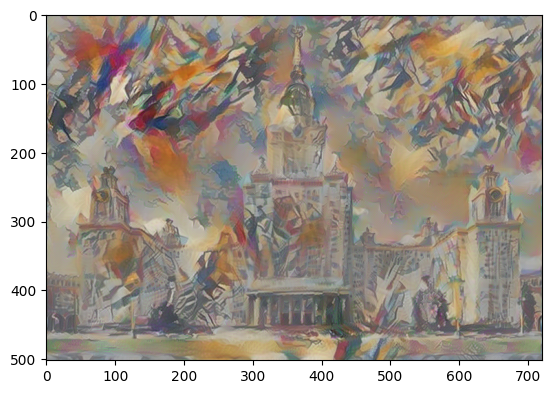

Iteration 900: Total Loss = 37838.40234375


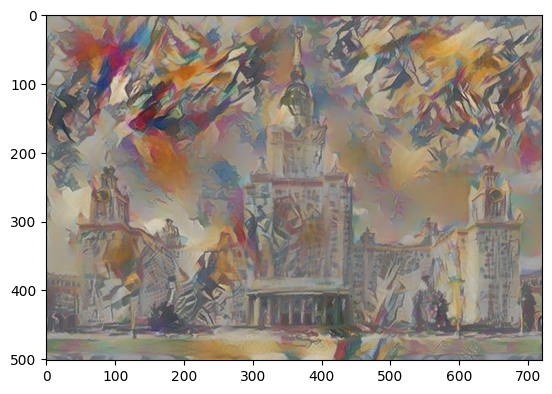

Iteration 1000: Total Loss = 36521.1953125


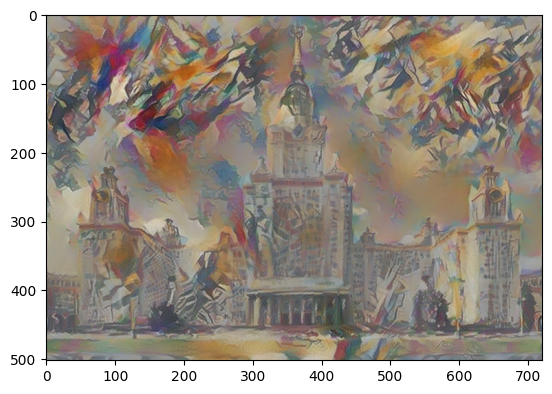

Iteration 1100: Total Loss = 35414.9921875


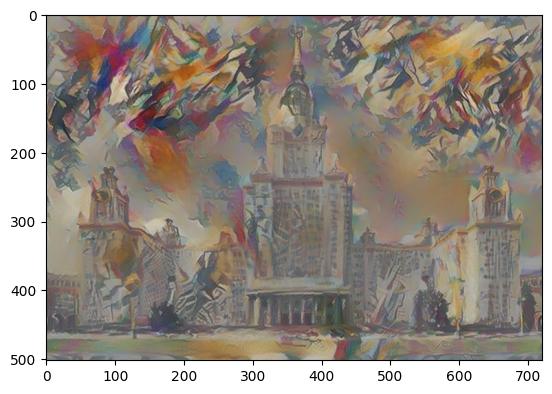

Iteration 1200: Total Loss = 34523.58984375


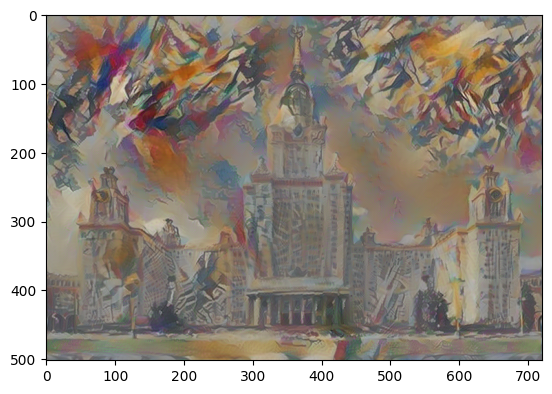

Iteration 1300: Total Loss = 33753.82421875


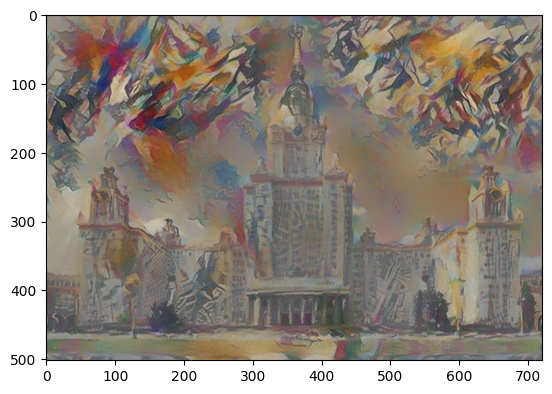

Iteration 1400: Total Loss = 33129.4296875


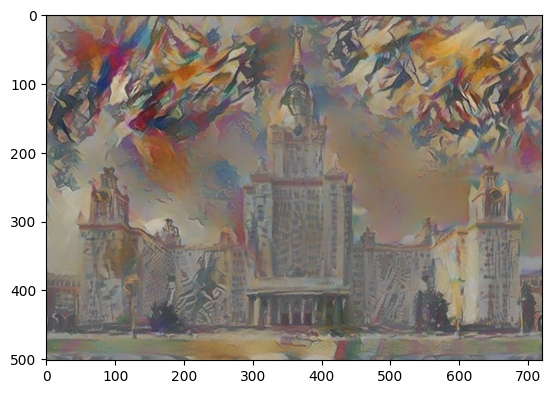

Iteration 1500: Total Loss = 32611.33203125


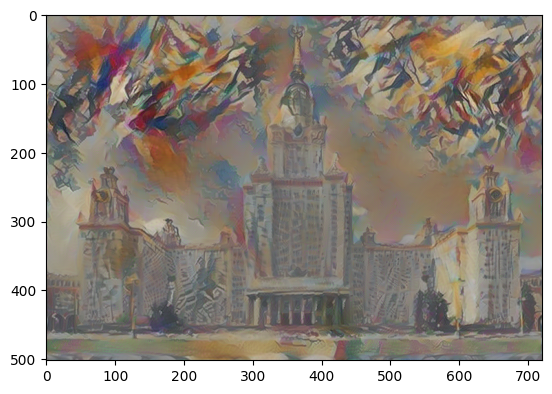

Iteration 1600: Total Loss = 32201.2578125


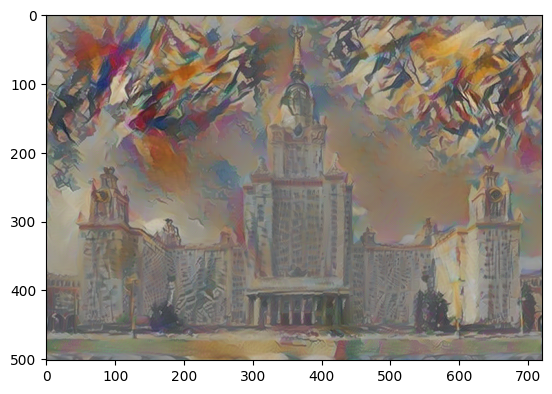

Iteration 1700: Total Loss = 31887.16015625


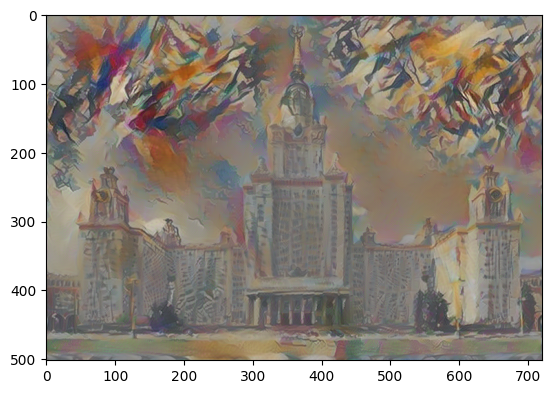

Iteration 1800: Total Loss = 31651.033203125


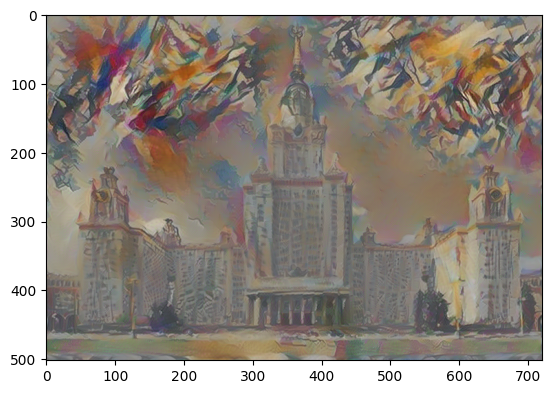

Iteration 1900: Total Loss = 31470.5


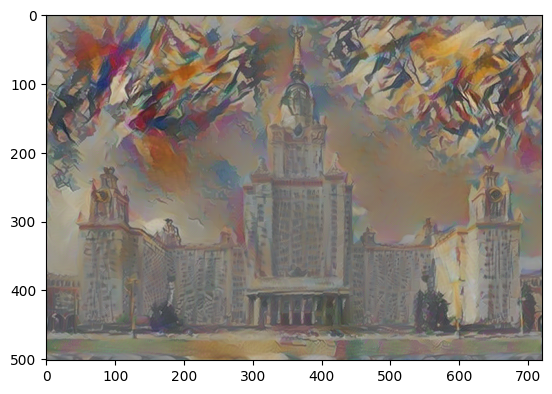

Iteration 2000: Total Loss = 31334.6484375


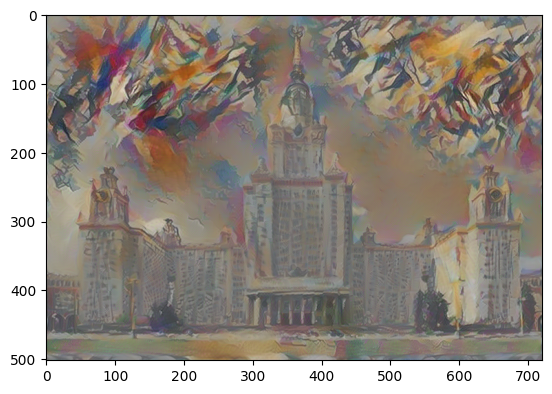

Iteration 2100: Total Loss = 31226.08984375


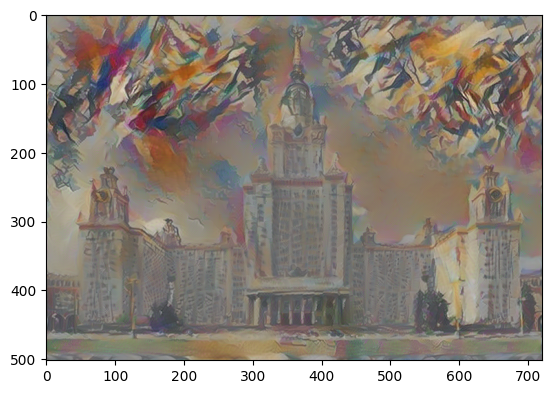

Iteration 2200: Total Loss = 31140.603515625


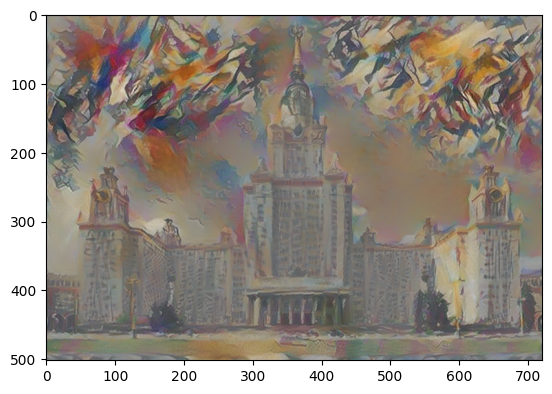

Iteration 2300: Total Loss = 31068.88671875


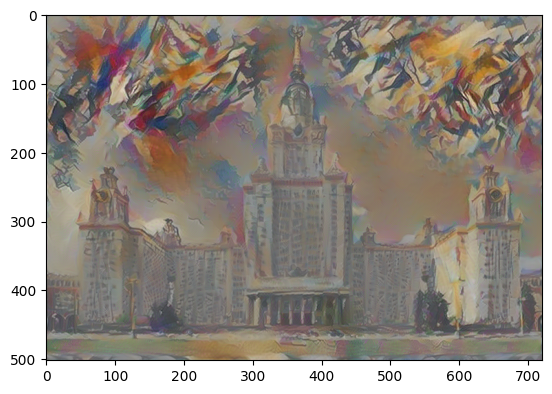

Iteration 2400: Total Loss = 31003.83984375


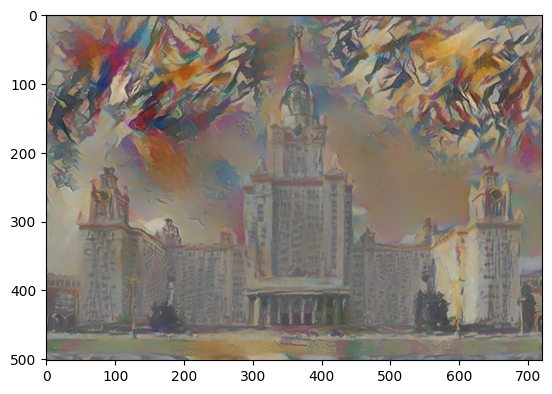

Iteration 2500: Total Loss = 30946.828125


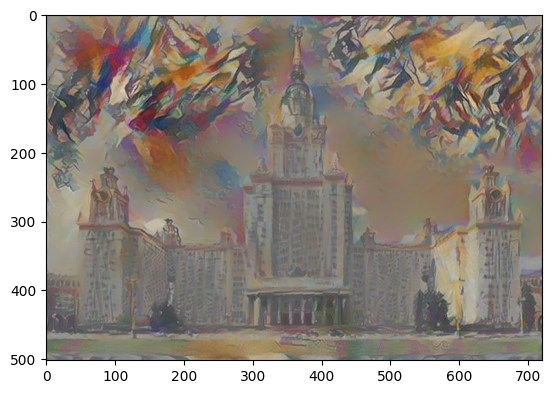

Iteration 2600: Total Loss = 30895.185546875


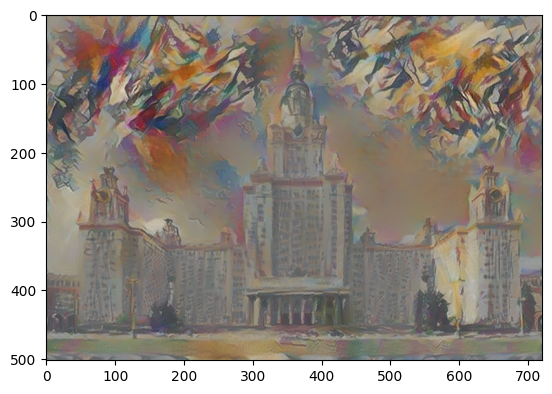

Iteration 2700: Total Loss = 30850.53125


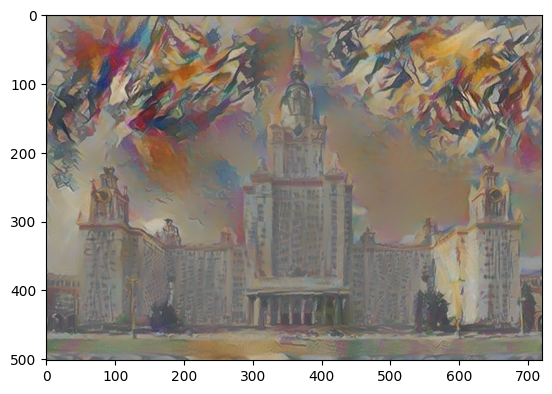

Iteration 2800: Total Loss = 30809.4375


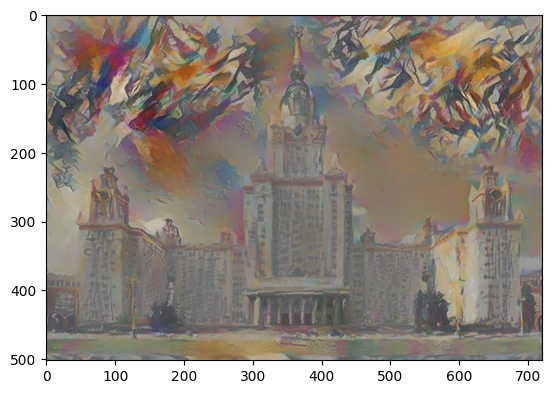

Iteration 2900: Total Loss = 30774.44140625


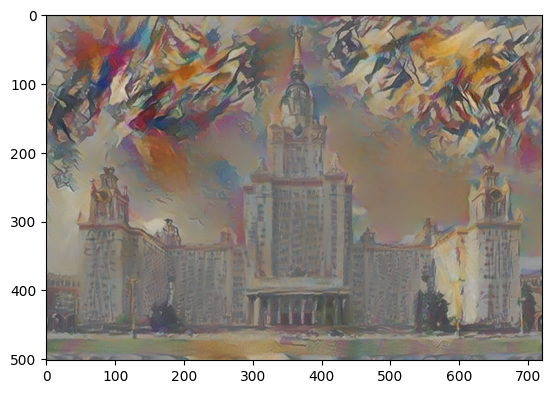

Iteration 3000: Total Loss = 30742.759765625


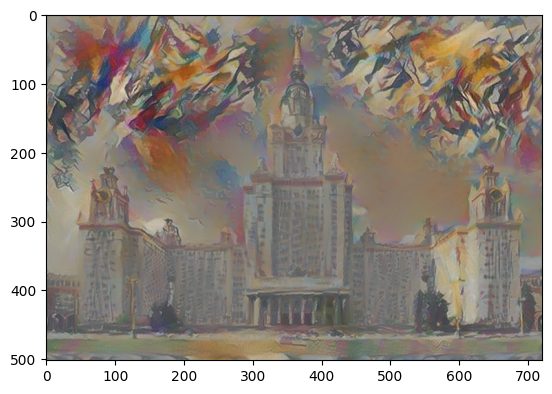

Iteration 3100: Total Loss = 30713.77734375


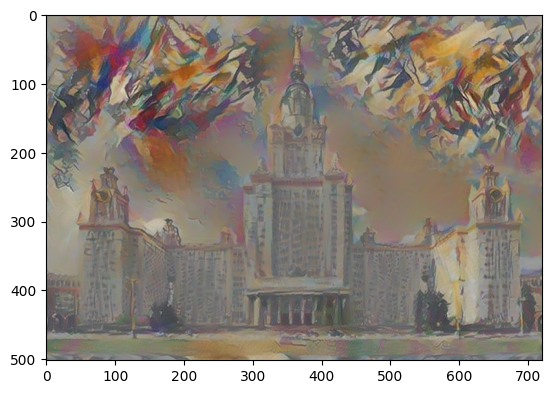

Iteration 3200: Total Loss = 30687.0390625


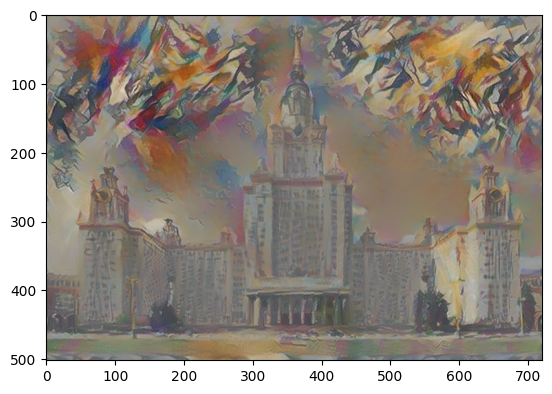

Iteration 3300: Total Loss = 30664.27734375


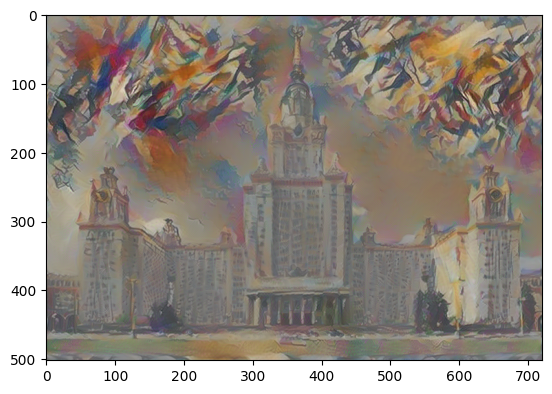

Iteration 3400: Total Loss = 30643.92578125


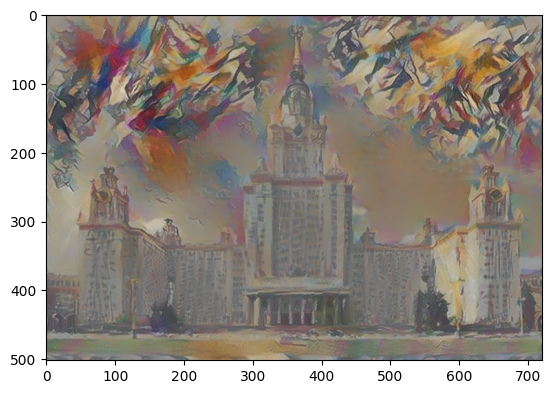

Iteration 3500: Total Loss = 30625.7265625


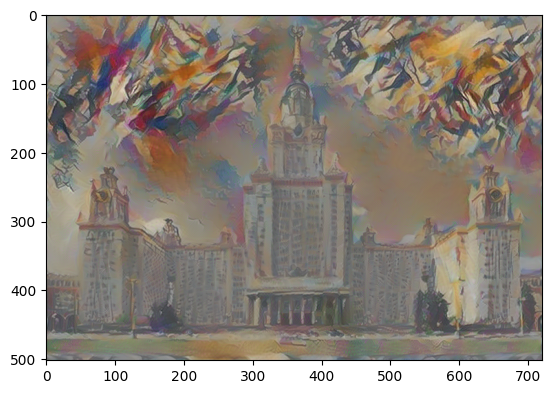

Iteration 3600: Total Loss = 30609.55859375


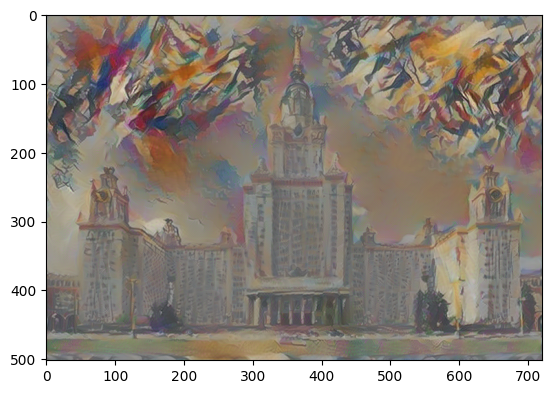

Iteration 3700: Total Loss = 30594.376953125


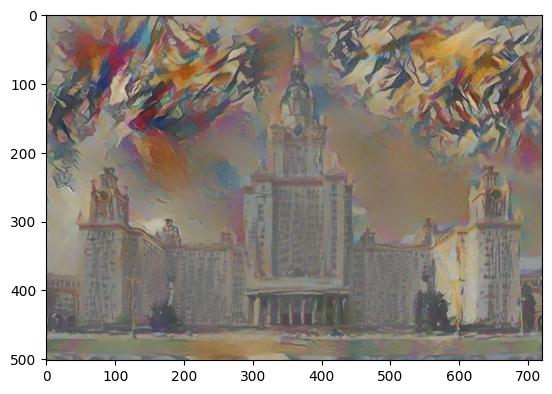

Iteration 3800: Total Loss = 30579.60546875


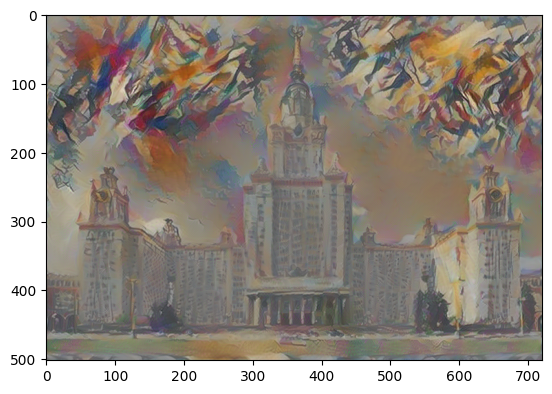

Iteration 3900: Total Loss = 30566.37109375


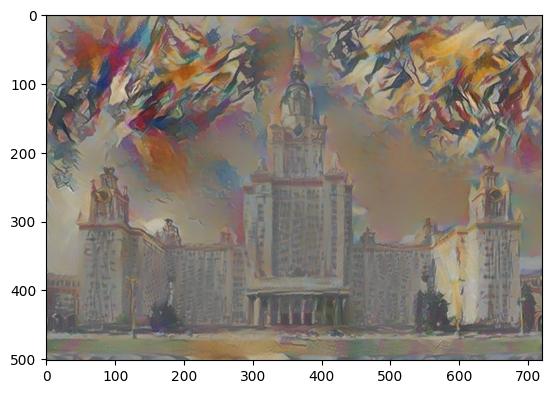

Iteration 4000: Total Loss = 30553.78125


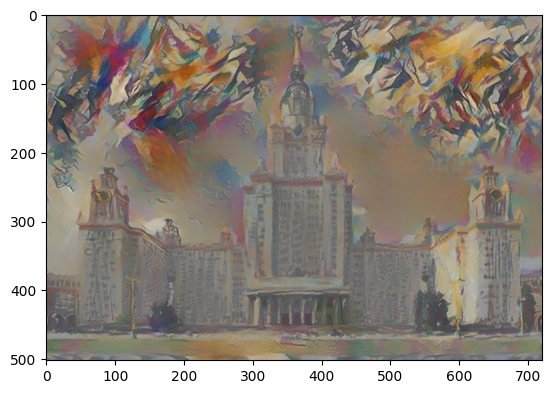

In [33]:
optimizer.step(closure);

Final Iteration


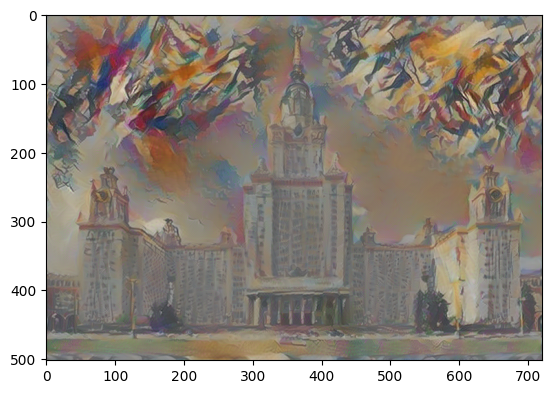

In [34]:
print('Final Iteration')
plt.imshow(prepare_output(noisy_tensor.clone().detach()))
plt.show()

Если всё сделано правильно, то получится некоторое абстрактное представление стиля в картине «Композиция VII» Кандинского.

### Задача 4 [2 дополнительных балла]

Реализуй экстракцию стиля изображения `comp_7`, используя `Adam` вместо L-BFGS. **[2 дополнительных балла]**

## Style Transfer

Наконец, осталось собрать все предыдущие шаги вместе.

### Задача 5 [4 балла]

In [35]:
model = init_model(device)

content_layer = 22
style_layers = [1, 6, 11, 20, 29]

Инициализируй картинку с шумом. **[0,05 балла]**

In [36]:
noisy_img = np.random.randint(0, 256, main.shape, dtype=np.uint8)

На практике работает лучше, если инициализировать итоговый тензор не чистым шумом, а чем-то ближе к оригинальной картинке содержания (`content_image`).

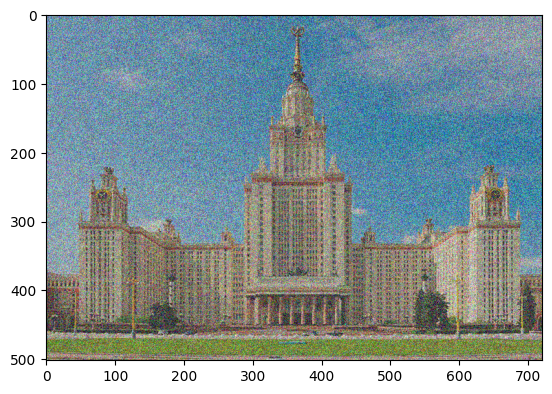

In [37]:
noisy_img = ((noisy_img.astype(np.float32) + main.astype(np.float32)) // 2).astype(np.uint8)
plt.imshow(noisy_img)

In [38]:
noisy_tensor = prepare_input(noisy_img)
noisy_tensor = noisy_tensor.to(device).requires_grad_(True)

Инициализируй целевые эмбеддинги содержания и стиля. **[0,25 балла]**

In [40]:
model = init_model(device)

content_activation = SaveFeature(model, content_layer)
model(main_tensor)
target_content_emb = content_activation.features.clone().detach().to(device)

style_activations = [SaveFeature(model, l) for l in style_layers]
model(comp_7_tensor)
style_grams_gt = get_grams(style_activations, detach=True)

In [41]:
content_criterion = torch.nn.MSELoss(reduction='mean')
style_criterion = torch.nn.MSELoss(reduction='sum')

In [42]:
num_iter = 3000
optimizer = torch.optim.LBFGS((noisy_tensor, ), max_iter=num_iter, lr=1.5,
                              tolerance_grad=0, tolerance_change=0, line_search_fn='strong_wolfe')

Финальный этап — объединение двух подходов. Оптимизируем шумную картинку по сумме двух функций потерь, взятых с определёнными коэффициентами:

$$
L_{\text{total}}(\tilde{C}, \tilde{S}, \tilde{X}) = \alpha L_{\text{content}}(\tilde{C}, \tilde{X}) + \beta L_{\text{style}}(\tilde{S}, \tilde{X}).
$$


Здесь предложены значения по умолчанию, но можно попробовать другие, главное в этом домашнем задании — получить эстетическое удовольствие.

Заполни пропуски в функции `closure`. **[1,7 балла]**

In [43]:
style_coef = 1e5
content_coef = 1e1

plot_every = 100
plot_counter = 0

def closure():
    global plot_counter
    optimizer.zero_grad()

    model(noisy_tensor)
    content_loss = content_coef * content_criterion(content_activation.features, target_content_emb)

    curr_style_grams = get_grams(style_activations)
    style_loss = style_coef * calculate_style_loss(style_criterion, style_grams_gt, curr_style_grams)

    total_loss = content_loss + style_loss
    total_loss.backward()

    if plot_counter % 100 == 0:
        print(f"Iteration {plot_counter}: Content Loss: {content_loss.item()}, Style Loss: {style_loss.item()}")
        plt.imshow(prepare_output(noisy_tensor.clone().detach()))
        plt.show()
    plot_counter += 1
    return total_loss

### Задача 6 [1 дополнительный балл]

Выбери свою картинку содержания, картинку стиля, подбери свои гиперпараметры.

Поделись наиболее удачным результатом. **[1 дополнительный балл]**